In [62]:
import tensorflow as tf
import helperFunctions as hf
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.metrics import accuracy_score, confusion_matrix
import pandas as pd


import cv2
import os
from IPython.display import Image, display
from tensorflow.keras.preprocessing import image
import matplotlib.cm as c_map

import warnings
warnings.filterwarnings('ignore')

In [41]:
def vectorize_image(img_path,height=240,width=240):
    '''
    Vectorize the given image to get a numpy array
    '''
    img=cv2.imread(img_path)
    resized=cv2.resize(img,(height,width))
    resized = np.array(resized).reshape((-1,height,width,3))
    return resized

def get_heatmap(sample, model_angle, last_conv_layer, pred_index=None):
    '''
    Function to visualize grad-cam heatmaps
    '''
    gradient_model = tf.keras.models.Model(
        [model_angle.inputs], [model_angle.get_layer(last_conv_layer).output, model_angle.output]
    )

    # Gradient Computations
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = gradient_model(sample)
        #print(preds)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]
    #print(class_channel)
    grads = tape.gradient(class_channel, last_conv_layer_output)
    pooled_grads = tf.reduce_mean(grads,axis = (0,1,2))
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap) # Normalize the heatmap
    return heatmap.numpy()

def superimpose_gradcam(img_path,heatmap, alpha=0.8):
    '''
    Superimpose Grad-CAM Heatmap on image
    '''
    img = image.load_img(img_path)
    img = image.img_to_array(img)
    #folder_path = r'C:\Users\Rohit Varre\Desktop\MliS\Dummy\Grad_Cam_Images'

    heatmap = np.uint8(255 * heatmap) # Back scaling to 0-255 from 0 - 1
    jet = c_map.get_cmap("jet") # Colorizing heatmap
    jet_colors = jet(np.arange(256))[:, :3] # Using RGB values
    jet_heatmap = jet_colors[heatmap]
    jet_heatmap = image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = image.img_to_array(jet_heatmap)

    
    superimposed_img = jet_heatmap * alpha + img # Superimposing the heatmap on original image
    #superimposed_img = image.array_to_img(superimposed_img)
    return superimposed_img

In [25]:
model_path = r'model_outputs\EfficientNetB2Basev2\saved_model\speed_model'
model = tf.keras.models.load_model(model_path)
model.layers[-1].activation = None
model.summary()

Model: "model_7"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_layer (InputLayer)       [(None, 240, 240, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling_8 (Rescaling)        (None, 240, 240, 3)  0           ['input_layer[0][0]']            
                                                                                                  
 normalization_8 (Normalization  (None, 240, 240, 3)  7          ['rescaling_8[0][0]']            
 )                                                                                                
                                                                                            

                                                                                                  
 block2a_expand_conv (Conv2D)   (None, 120, 120, 96  1536        ['block1b_add[0][0]']            
                                )                                                                 
                                                                                                  
 block2a_expand_bn (BatchNormal  (None, 120, 120, 96  384        ['block2a_expand_conv[0][0]']    
 ization)                       )                                                                 
                                                                                                  
 block2a_expand_activation (Act  (None, 120, 120, 96  0          ['block2a_expand_bn[0][0]']      
 ivation)                       )                                                                 
                                                                                                  
 block2a_d

 block2c_expand_activation (Act  (None, 60, 60, 144)  0          ['block2c_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block2c_dwconv (DepthwiseConv2  (None, 60, 60, 144)  1296       ['block2c_expand_activation[0][0]
 D)                                                              ']                               
                                                                                                  
 block2c_bn (BatchNormalization  (None, 60, 60, 144)  576        ['block2c_dwconv[0][0]']         
 )                                                                                                
                                                                                                  
 block2c_activation (Activation  (None, 60, 60, 144)  0          ['block2c_bn[0][0]']             
 )        

 )                                                                                                
                                                                                                  
 block3b_activation (Activation  (None, 30, 30, 288)  0          ['block3b_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block3b_se_squeeze (GlobalAver  (None, 288)         0           ['block3b_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block3b_se_reshape (Reshape)   (None, 1, 1, 288)    0           ['block3b_se_squeeze[0][0]']     
                                                                                                  
 block3b_s

 block4a_activation (Activation  (None, 15, 15, 288)  0          ['block4a_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block4a_se_squeeze (GlobalAver  (None, 288)         0           ['block4a_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block4a_se_reshape (Reshape)   (None, 1, 1, 288)    0           ['block4a_se_squeeze[0][0]']     
                                                                                                  
 block4a_se_reduce (Conv2D)     (None, 1, 1, 12)     3468        ['block4a_se_reshape[0][0]']     
                                                                                                  
 block4a_s

 block4c_se_expand (Conv2D)     (None, 1, 1, 528)    12144       ['block4c_se_reduce[0][0]']      
                                                                                                  
 block4c_se_excite (Multiply)   (None, 15, 15, 528)  0           ['block4c_activation[0][0]',     
                                                                  'block4c_se_expand[0][0]']      
                                                                                                  
 block4c_project_conv (Conv2D)  (None, 15, 15, 88)   46464       ['block4c_se_excite[0][0]']      
                                                                                                  
 block4c_project_bn (BatchNorma  (None, 15, 15, 88)  352         ['block4c_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block4c_d

 block5a_project_conv (Conv2D)  (None, 15, 15, 120)  63360       ['block5a_se_excite[0][0]']      
                                                                                                  
 block5a_project_bn (BatchNorma  (None, 15, 15, 120)  480        ['block5a_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block5b_expand_conv (Conv2D)   (None, 15, 15, 720)  86400       ['block5a_project_bn[0][0]']     
                                                                                                  
 block5b_expand_bn (BatchNormal  (None, 15, 15, 720)  2880       ['block5b_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block5b_e

 block5d_expand_conv (Conv2D)   (None, 15, 15, 720)  86400       ['block5c_add[0][0]']            
                                                                                                  
 block5d_expand_bn (BatchNormal  (None, 15, 15, 720)  2880       ['block5d_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block5d_expand_activation (Act  (None, 15, 15, 720)  0          ['block5d_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block5d_dwconv (DepthwiseConv2  (None, 15, 15, 720)  18000      ['block5d_expand_activation[0][0]
 D)                                                              ']                               
          

                                                                                                  
 block6b_dwconv (DepthwiseConv2  (None, 8, 8, 1248)  31200       ['block6b_expand_activation[0][0]
 D)                                                              ']                               
                                                                                                  
 block6b_bn (BatchNormalization  (None, 8, 8, 1248)  4992        ['block6b_dwconv[0][0]']         
 )                                                                                                
                                                                                                  
 block6b_activation (Activation  (None, 8, 8, 1248)  0           ['block6b_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block6b_s

 )                                                                                                
                                                                                                  
 block6d_activation (Activation  (None, 8, 8, 1248)  0           ['block6d_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block6d_se_squeeze (GlobalAver  (None, 1248)        0           ['block6d_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block6d_se_reshape (Reshape)   (None, 1, 1, 1248)   0           ['block6d_se_squeeze[0][0]']     
                                                                                                  
 block6d_s

 block7a_se_squeeze (GlobalAver  (None, 1248)        0           ['block7a_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block7a_se_reshape (Reshape)   (None, 1, 1, 1248)   0           ['block7a_se_squeeze[0][0]']     
                                                                                                  
 block7a_se_reduce (Conv2D)     (None, 1, 1, 52)     64948       ['block7a_se_reshape[0][0]']     
                                                                                                  
 block7a_se_expand (Conv2D)     (None, 1, 1, 1248)   66144       ['block7a_se_reduce[0][0]']      
                                                                                                  
 block7a_se_excite (Multiply)   (None, 8, 8, 1248)   0           ['block7a_activation[0][0]',     
          

In [26]:
last_conv_layer = "stem_conv"

### Loading the validation data

In [27]:
valid_ds = hf.getTfDataset( path='data\\validationData.csv', angle=False, speed=True, 
                           img_height=240, img_width= 240,shuffle=False)
df_valid = pd.read_csv(r"data\validationData.csv")
df_valid.head(3)

,image_id,angle,speed,image_path
0,8272,0.8125,1.0,data\v0\training_data\8272.png
1,12660,0.8125,1.0,data\v0\training_data\12660.png
2,5129,0.6875,1.0,data\v0\training_data\5129.png


In [28]:
valid_preds = model_speed.predict(valid_ds)

40/40 [==============================] - 6s 140ms/step


In [29]:
valid_preds = np.where(valid_preds>0.5,1,0)
accuracy_score(df_valid["speed"].to_list(),valid_preds)

0.978125

### Loading test Data

In [30]:
test_ds = hf.getTfDataset( path='data\\testData.csv', angle=False, speed=True, 
                           img_height=240, img_width= 240,shuffle=False)
df_test = pd.read_csv(r"data\testData.csv")
df_test.head(3)

,image_id,angle,speed,image_path
0,3560,0.5625,1.0,data\v0\training_data\3560.png
1,11953,0.5625,0.0,data\v0\training_data\11953.png
2,10744,0.5625,1.0,data\v0\training_data\10744.png


In [31]:
test_preds = model_speed.predict(test_ds)
test_preds = np.where(test_preds>0.5,1,0)

32/32 [==============================] - 4s 141ms/step


In [32]:
accuracy_score(df_test["speed"].to_list(),test_preds)

0.981

In [33]:
confusion_matrix(df_test["speed"].to_list(),test_preds)

array([[485,  15],
       [  4, 496]], dtype=int64)

### Analysis on test data

In [34]:
test_preds = np.squeeze(test_preds)
df_test['pred_speed'] = test_preds
df_test.head(2)

,image_id,angle,speed,image_path,pred_speed
0,3560,0.5625,1.0,data\v0\training_data\3560.png,1
1,11953,0.5625,0.0,data\v0\training_data\11953.png,0


In [49]:
wrong_preds = list(df_test[df_test['speed']!=df_test['pred_speed']][["image_path","speed","pred_speed"]].to_records())
wrong_preds

[(24, 'data\\v0\\training_data\\1825.png', 0., 1),
 (43, 'data\\v0\\training_data\\5050.png', 0., 1),
 (204, 'data\\v0\\training_data\\12680.png', 0., 1),
 (226, 'data\\v0\\training_data\\10024.png', 0., 1),
 (237, 'data\\v0\\training_data\\6557.png', 1., 0),
 (258, 'data\\v0\\training_data\\7192.png', 1., 0),
 (304, 'data\\v0\\training_data\\10858.png', 0., 1),
 (326, 'data\\v0\\training_data\\1845.png', 0., 1),
 (377, 'data\\v0\\training_data\\9549.png', 1., 0),
 (532, 'data\\v0\\training_data\\13134.png', 0., 1),
 (605, 'data\\v0\\training_data\\10947.png', 0., 1),
 (687, 'data\\v0\\training_data\\11928.png', 0., 1),
 (696, 'data\\v0\\training_data\\1430.png', 0., 1),
 (711, 'data\\v0\\training_data\\29.png', 0., 1),
 (720, 'data\\v0\\training_data\\1721.png', 0., 1),
 (861, 'data\\v0\\training_data\\5611.png', 0., 1),
 (879, 'data\\v0\\training_data\\8635.png', 0., 1),
 (881, 'data\\v0\\training_data\\8932.png', 0., 1),
 (943, 'data\\v0\\training_data\\10902.png', 1., 0)]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

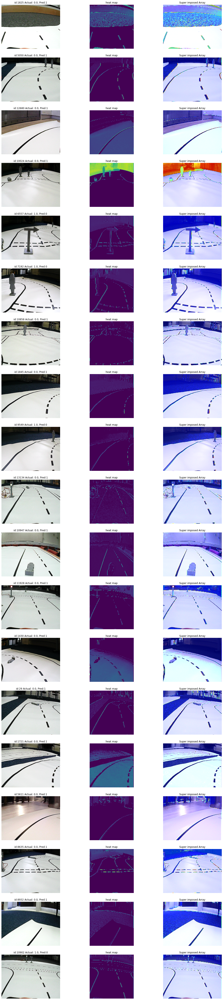

In [60]:
#wrong_preds

### Some images
i=0
n = len(wrong_preds)
plt.figure(figsize=(20, n+70))
while i < len(wrong_preds):
    ax = plt.subplot(n, 3, i*3 + 1)
    plt.imshow(plt.imread(wrong_preds[i][1]))
    id = wrong_preds[i][1].split("\\")[-1].split(".")[0]
    label = f"id:{id} Actual: {wrong_preds[i][2]}, Pred:{wrong_preds[i][3]}"
    plt.title(label)
    plt.axis("off")
    
    ax = plt.subplot(n, 3, i*3 + 2)
    sample = vectorize_image(wrong_preds[i][1])
    plt.imshow(get_heatmap(sample, model, last_conv_layer))    
    plt.title("heat map")
    plt.axis("off")
    
    ax = plt.subplot(n, 3, i*3 + 3)
    img_array = superimpose_gradcam(wrong_preds[i][1], get_heatmap(sample, model, last_conv_layer))/255
    plt.imshow(img_array)
    plt.title("Super imposed Array")
    plt.axis("off")
    
    i += 1



## Some wrong preds from validation data

In [65]:
valid_preds = np.squeeze(valid_preds)
df_valid['pred_speed'] = valid_preds
df_valid.head()

wrong_preds = list(df_valid[df_valid['speed']!=df_valid['pred_speed']][["image_path","speed","pred_speed"]].to_records())
wrong_preds

[(11, 'data\\v0\\training_data\\7805.png', 1., 0),
 (18, 'data\\v0\\training_data\\3151.png', 1., 0),
 (120, 'data\\v0\\training_data\\5601.png', 0., 1),
 (204, 'data\\v0\\training_data\\4909.png', 1., 0),
 (227, 'data\\v0\\training_data\\7208.png', 0., 1),
 (255, 'data\\v0\\training_data\\851.png', 1., 0),
 (363, 'data\\v0\\training_data\\12495.png', 0., 1),
 (380, 'data\\v0\\training_data\\8892.png', 0., 1),
 (398, 'data\\v0\\training_data\\8717.png', 1., 0),
 (451, 'data\\v0\\training_data\\4859.png', 1., 0),
 (485, 'data\\v0\\training_data\\2284.png', 0., 1),
 (515, 'data\\v0\\training_data\\13259.png', 1., 0),
 (521, 'data\\v0\\training_data\\1828.png', 0., 1),
 (528, 'data\\v0\\training_data\\4238.png', 0., 1),
 (584, 'data\\v0\\training_data\\10383.png', 1., 0),
 (670, 'data\\v0\\training_data\\3854.png', 0., 1),
 (711, 'data\\v0\\training_data\\2504.png', 0., 1),
 (716, 'data\\v0\\training_data\\11255.png', 1., 0),
 (721, 'data\\v0\\training_data\\6533.png', 0., 1),
 (724, 'dat

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

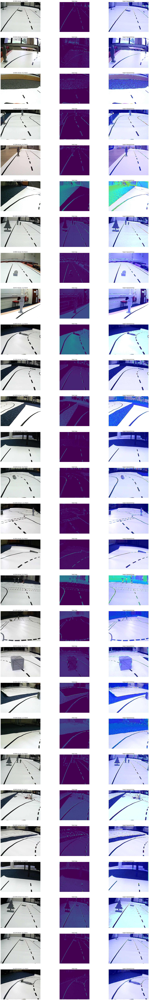

In [68]:
#wrong_preds

### Some images
i=0
n = len(wrong_preds)
plt.figure(figsize=(30, 200))
while i < len(wrong_preds):
    ax = plt.subplot(n, 3, i*3 + 1)
    plt.imshow(plt.imread(wrong_preds[i][1]))
    id = wrong_preds[i][1].split("\\")[-1].split(".")[0]
    label = f"id:{id} Actual: {wrong_preds[i][2]}, Pred:{wrong_preds[i][3]}"
    plt.title(label)
    plt.axis("off")
    
    ax = plt.subplot(n, 3, i*3 + 2)
    sample = vectorize_image(wrong_preds[i][1])
    plt.imshow(get_heatmap(sample, model, last_conv_layer))    
    plt.title("heat map")
    plt.axis("off")
    
    ax = plt.subplot(n, 3, i*3 + 3)
    img_array = superimpose_gradcam(wrong_preds[i][1], get_heatmap(sample, model, last_conv_layer))/255
    plt.imshow(img_array)
    plt.title("Super imposed Array")
    plt.axis("off")
    
    i += 1